## Skeleton Code

The code below provides a skeleton for the model building & training component of your project. You can add/remove/build on code however you see fit, this is meant as a starting point.

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os
from glob import glob
import matplotlib.pyplot as plt
import tensorflow as tf
%matplotlib inline

from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession
config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)

import sklearn.model_selection as skl
from sklearn.metrics import confusion_matrix, roc_curve, roc_auc_score, f1_score, precision_recall_curve, precision_score, recall_score, ConfusionMatrixDisplay
from keras.preprocessing.image import ImageDataGenerator
from keras.layers import Dense, Dropout, Flatten
from keras.models import Sequential, Model
from keras.applications.vgg16 import VGG16
from keras.applications.resnet import ResNet50
from keras.optimizers import Adam
from keras.callbacks import ModelCheckpoint, LearningRateScheduler, EarlyStopping, ReduceLROnPlateau##Import any other stats/DL/ML packages you may need here. E.g. Keras, scikit-learn, etc.

Using TensorFlow backend.


## Do some early processing of your metadata for easier model training:

In [2]:
## Below is some helper code to read all of your full image filepaths into a dataframe for easier manipulation

all_xray_df = pd.read_csv('/data/Data_Entry_2017.csv')
all_image_paths = {os.path.basename(x): x for x in 
                   glob(os.path.join('/data','images*', '*', '*.png'))}
print('Scans found:', len(all_image_paths), ', Total Headers', all_xray_df.shape[0])
all_xray_df['path'] = all_xray_df['Image Index'].map(all_image_paths.get)
all_xray_df.sample(3)

Scans found: 112120 , Total Headers 112120


,Image Index,Finding Labels,Follow-up #,Patient ID,Patient Age,Patient Gender,View Position,OriginalImage[Width,Height],OriginalImagePixelSpacing[x,y],Unnamed: 11,path
51592,00013031_027.png,No Finding,27,13031,54,M,PA,2906,2991,0.143,0.143,NaN,/data/images_006/images/00013031_027.png
16039,00004269_005.png,Nodule,5,4269,39,M,AP,2500,2048,0.168,0.168,NaN,/data/images_003/images/00004269_005.png
96068,00025272_000.png,No Finding,0,25272,56,F,PA,2374,2991,0.143,0.143,NaN,/data/images_011/images/00025272_000.png


In [3]:
## Here you may want to create some extra columns in your table with binary indicators of certain diseases 
## rather than working directly with the 'Finding Labels' column

all_diseases = set()
for finding in all_xray_df['Finding Labels']:
    for disease in finding.split('|'):
        all_diseases.add(disease)

all_diseases = list(all_diseases)
for disease in all_diseases:
    all_xray_df[disease] = all_xray_df['Finding Labels'].map(lambda x: disease in x.split('|')).astype(int)

## Create your training and testing data:

In [4]:
def create_splits(df, test_size, stratify):
    ## Either build your own or use a built-in library to split your original dataframe into two sets 
    ## that can be used for training and testing your model
    ## It's important to consider here how balanced or imbalanced you want each of those sets to be
    ## for the presence of pneumonia

    train_df, valid_df = skl.train_test_split(df, test_size=test_size, stratify=df[stratify])
    train_positive = train_df[train_df[stratify] == True]
    train_negative = train_df[train_df[stratify] == False].sample(n=train_positive.shape[0])

    val_positive = valid_df[valid_df[stratify] == True]
    val_negative = valid_df[valid_df[stratify] == False].sample(n=4*val_positive.shape[0])

    train_data = pd.concat([train_positive, train_negative]).sample(frac=1.0)
    val_data = pd.concat([val_positive, val_negative]).sample(frac=1.0)

    return train_data, val_data


# Now we can begin our model-building & training

#### First suggestion: perform some image augmentation on your data

In [5]:
def my_image_augmentation(height_shift_range=0, width_shift_range=0, rotation_range=0, shear_range=0, zoom_range=0):
    
    ## recommendation here to implement a package like Keras' ImageDataGenerator
    ## with some of the built-in augmentations 
    
    ## keep an eye out for types of augmentation that are or are not appropriate for medical imaging data
    ## Also keep in mind what sort of augmentation is or is not appropriate for testing vs validation data
    
    ## STAND-OUT SUGGESTION: implement some of your own custom augmentation that's *not*
    ## built into something like a Keras package
    
    return ImageDataGenerator(rescale=1. / 255,
                                horizontal_flip=False,
                                vertical_flip=False,
                                height_shift_range=height_shift_range,
                                width_shift_range=width_shift_range,
                                rotation_range=rotation_range,
                                shear_range=shear_range,
                                zoom_range=zoom_range,
                                samplewise_center=True,
                                samplewise_std_normalization=True
                                )

def make_train_gen(idg, df):
    
    ## Create the actual generators using the output of my_image_augmentation for your training data
    ## Suggestion here to use the flow_from_dataframe library, e.g.:
    
    return idg.flow_from_dataframe(dataframe=df,
                                        directory=None,
                                        x_col='path',
                                        y_col='Pneumonia',
                                        class_mode='raw',
                                        target_size=(224, 224),
                                        batch_size=100,
                                        seed=7
                                        )

def make_val_gen(idg, df):
    
    return idg.flow_from_dataframe(dataframe=df,
                                      directory=None,
                                      x_col='path',
                                      y_col='Pneumonia',
                                      class_mode='raw',
                                      target_size=(224, 224),
                                      batch_size=625,
                                      seed=7
                                      )


In [6]:
## May want to pull a single large batch of random validation data for testing after each epoch:
train, val = create_splits(all_xray_df, 0.2, 'Pneumonia')

train_idg = my_image_augmentation(0.1, 0.1, 15, 0.15, 0.2)
val_idg = my_image_augmentation()
train_gen = make_train_gen(train_idg, train)
val_gen = make_val_gen(val_idg, val)
valX, valY = val_gen.next()

Found 2290 validated image filenames.
Found 1430 validated image filenames.


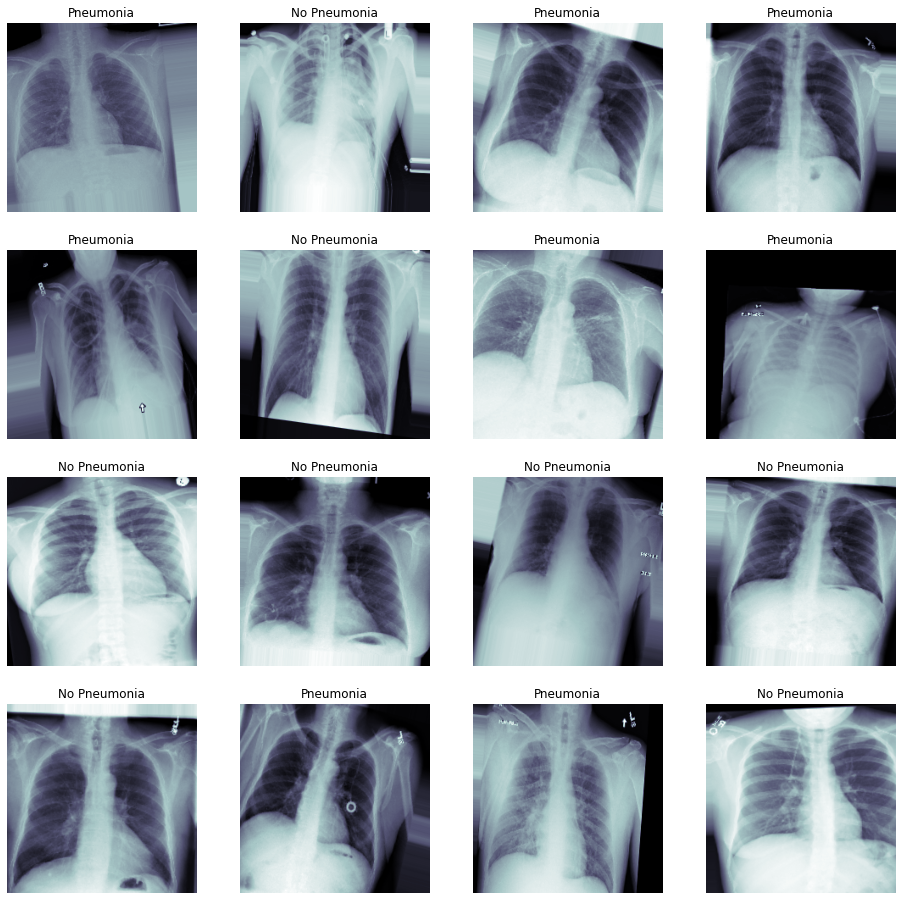

In [7]:
## May want to look at some examples of our augmented training data. 
## This is helpful for understanding the extent to which data is being manipulated prior to training, 
## and can be compared with how the raw data look prior to augmentation

t_x, t_y = next(train_gen)
fig, m_axs = plt.subplots(4, 4, figsize = (16, 16))
for (c_x, c_y, c_ax) in zip(t_x, t_y, m_axs.flatten()):
    c_ax.imshow(c_x[:,:,0], cmap = 'bone')
    if c_y == 1: 
        c_ax.set_title('Pneumonia')
    else:
        c_ax.set_title('No Pneumonia')
    c_ax.axis('off')

## Build your model: 

Recommendation here to use a pre-trained network downloaded from Keras for fine-tuning

In [8]:
def load_pretrained_model():
    model = VGG16(include_top=True, weights='imagenet')
    for layer in model.layers[:-7]:
        layer.trainable = False
    transfer_layer = model.get_layer('block5_pool')
    vgg_model = Model(inputs=model.input, outputs=transfer_layer.output)
    return vgg_model


In [9]:
def build_my_model(input_model):
    my_model = Sequential()

    my_model.add(input_model)

    # Flatten the output of the VGG16 model because it is from a
    # convolutional layer.
    my_model.add(Flatten())

    my_model.add(Dense(1024, activation='relu'))
    my_model.add(Dropout(0.5))
    
    my_model.add(Dense(1, activation='sigmoid'))

    return my_model



## STAND-OUT Suggestion: choose another output layer besides just the last classification layer of your modele
## to output class activation maps to aid in clinical interpretation of your model's results

In [10]:
## Below is some helper code that will allow you to add checkpoints to your model,
## This will save the 'best' version of your model by comparing it to previous epochs of training

## Note that you need to choose which metric to monitor for your model's 'best' performance if using this code. 
## The 'patience' parameter is set to 10, meaning that your model will train for ten epochs without seeing
## improvement before quitting

# Todo

weight_path=os.path.join(os.getcwd(), "xray_class_my_model.best.hdf5")

checkpoint = ModelCheckpoint(weight_path,
                             monitor='val_binary_accuracy',
                             verbose=1,
                             save_best_only=True,
                             mode='max',
                             save_weights_only=True)

early = EarlyStopping(monitor='val_binary_accuracy',
                      mode='max',
                      patience=10)

reduce_lr = ReduceLROnPlateau(monitor='val_binary_accuracy',
                              factor=0.1,
                              patience=10,
                              verbose=1,
                              mode="auto",
                              min_delta=0.0001,
                              min_lr=1e-6
                             )

callbacks_list = [checkpoint, early, reduce_lr]


### Start training! 

In [11]:
## train your model

my_model = build_my_model(load_pretrained_model())

optimizer = Adam(learning_rate=1e-4)
loss = 'binary_crossentropy'
metrics = ['binary_accuracy']

my_model.compile(optimizer=optimizer, loss=loss, metrics=metrics)

history = my_model.fit_generator(train_gen,
                          validation_data=(valX, valY),
                          epochs = 50,
                          callbacks = callbacks_list)

553467904/553467096 [==============================] - 5s 0us/step
Epoch 1/50
23/23 [==============================] - 83s 4s/step - loss: 0.8654 - binary_accuracy: 0.5288 - val_loss: 0.8008 - val_binary_accuracy: 0.2080

Epoch 00001: val_binary_accuracy improved from -inf to 0.20800, saving model to /home/workspace/xray_class_my_model.best.hdf5
Epoch 2/50
23/23 [==============================] - 64s 3s/step - loss: 0.6785 - binary_accuracy: 0.5699 - val_loss: 0.6557 - val_binary_accuracy: 0.5920

Epoch 00002: val_binary_accuracy improved from 0.20800 to 0.59200, saving model to /home/workspace/xray_class_my_model.best.hdf5
Epoch 3/50
23/23 [==============================] - 67s 3s/step - loss: 0.6559 - binary_accuracy: 0.6153 - val_loss: 0.6228 - val_binary_accuracy: 0.6336

Epoch 00003: val_binary_accuracy improved from 0.59200 to 0.63360, saving model to /home/workspace/xray_class_my_model.best.hdf5
Epoch 4/50
23/23 [==============================] - 66s 3s/step - loss: 0.6376 - bin

##### After training for some time, look at the performance of your model by plotting some performance statistics:

Note, these figures will come in handy for your FDA documentation later in the project

In [12]:
## After training, make some predictions to assess your model's overall performance
## Note that detecting pneumonia is hard even for trained expert radiologists, 
## so there is no need to make the model perfect.
my_model.load_weights(weight_path)
val_X, val_Y = val_gen.next()
pred_Y = my_model.predict(val_X, batch_size=32, verbose=True)

625/625 [==============================] - 11s 17ms/step


In [13]:
def generate_plots(y_t, y_p):
    fpr, tpr, thresholds = roc_curve(y_t, y_p)
    distances = [
        (fp**2 + (1 - tp)**2)**0.5 for fp, tp in zip(fpr, tpr)
    ]
    auc = roc_auc_score(y_t, y_p)
    best_threshold = thresholds[np.argmin(distances)]
    plt.figure(figsize=(10, 10))
    plt.title('AUC: {} | Best threshold: {}'.format(auc, best_threshold))
    plt.plot(fpr, tpr)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.show()
    
    precision = []
    recall = []
    f1 = []
    youden = []
    thresholds = [x for x in thresholds if x <= 1.0]
    sensitivities = []
    specificities = []
    for thresh in thresholds:
        if thresh > 1.0:
            continue
        predictions = [i >= thresh for i in y_p]
        tn, fp, fn, tp = confusion_matrix(y_t, predictions).ravel()
        sensitivity = (1.0 * tp) / (tp + fn)
        specificity = (1.0 * tn) / (tn + fp)
        sensitivities.append(sensitivity)
        specificities.append(specificity)
        youden.append(sensitivity + specificity - 1)
        precision.append(precision_score(y_t, predictions))
        recall.append(recall_score(y_t, predictions))
        f1.append(f1_score(y_t, predictions))
        
    max_youden_thresh = thresholds[np.argmax(youden)]
    max_f1_thresh = thresholds[np.argmax(f1)]
        
    plt.figure(figsize=(10, 10))
    plt.title('Precision/Recall/F1 | Best F1 Threshold: {}'.format(max_f1_thresh))
    plt.plot(thresholds, precision, color='r', label='Precision')
    plt.plot(thresholds, recall, color='g', label='Recall')
    plt.plot(thresholds, f1, color='b', label='F1')
    plt.xlabel('Threshold')
    plt.legend()
    plt.show()
    
    plt.figure(figsize=(10, 10))
    plt.title('Precision vs. Recall')
    plt.plot(recall, precision)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.show()
    
    plt.figure(figsize=(10, 10))
    plt.title('Sensitivity/Specificity')
    plt.plot(thresholds, sensitivities, 'r', label='Sensitivity')
    plt.plot(thresholds, specificities, 'b', label='Specificity')
    plt.xlabel('Threshold')
    plt.legend()
    plt.show()
    
    plt.figure(figsize=(10, 10))
    plt.title("Youden's index | Best Threshold: {}".format(max_youden_thresh))
    plt.plot(thresholds, youden)
    plt.xlabel('Threshold')
    plt.show()

## what other performance statistics do you want to include here besides AUC? 


# def ... 
# Todo

# def ...
# Todo
    
#Also consider plotting the history of your model training:

def plot_history(history):

    # Todo
    plt.figure(figsize=(10, 10))
    plt.plot(history.history['loss'], color='r', label='Training')
    plt.plot(history.history['val_loss'], color='b', label='Validation')
    plt.legend()
    plt.xlabel('Epoch')
    plt.title('Loss')
    plt.show()

    plt.figure(figsize=(10, 10))
    plt.plot(history.history['binary_accuracy'], color='r', label='Training')
    plt.plot(history.history['val_binary_accuracy'], color='b', label='Validation')
    plt.legend()
    plt.xlabel('Epoch')
    plt.title('Accuracy')
    plt.show()


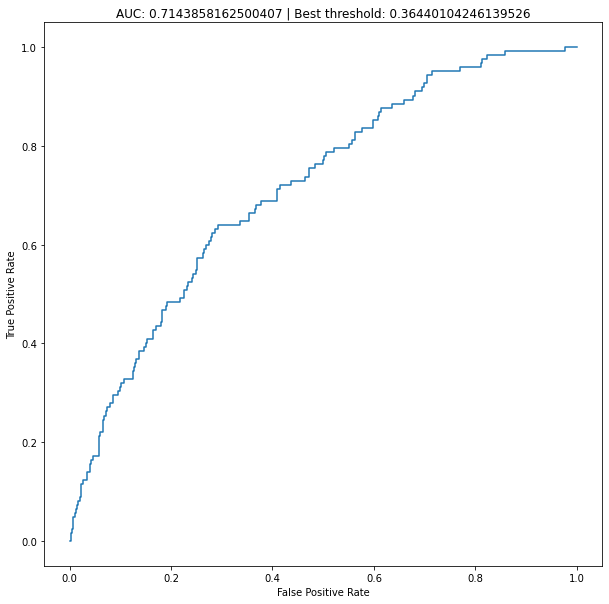

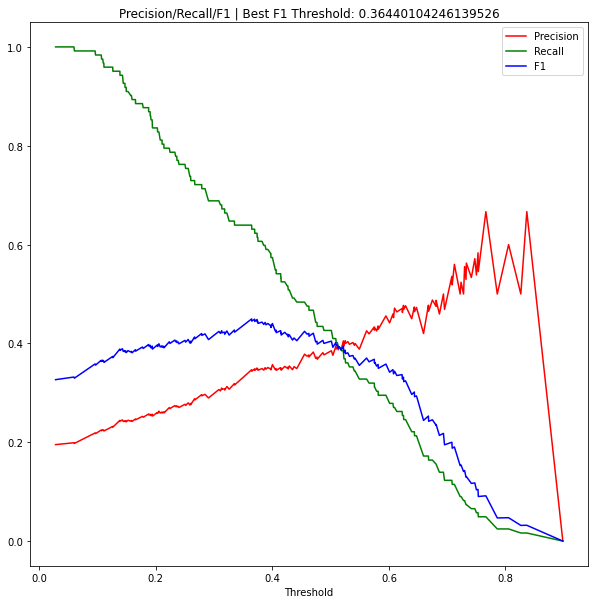

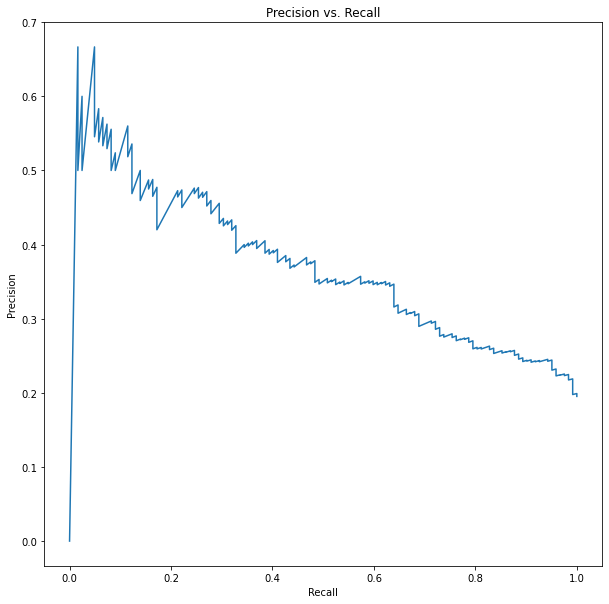

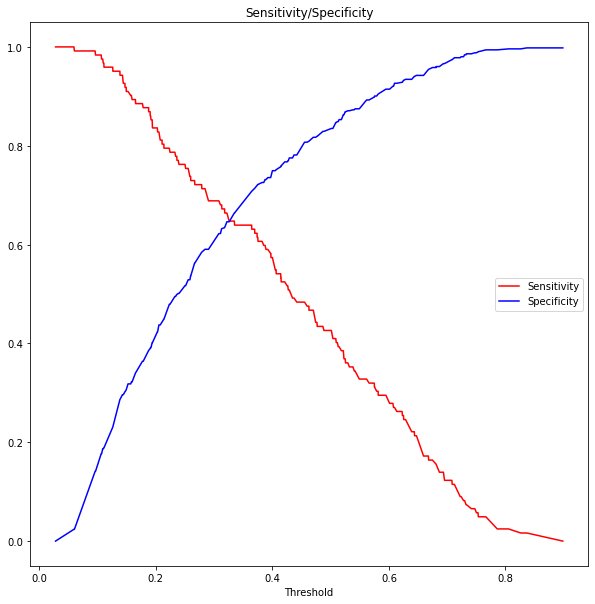

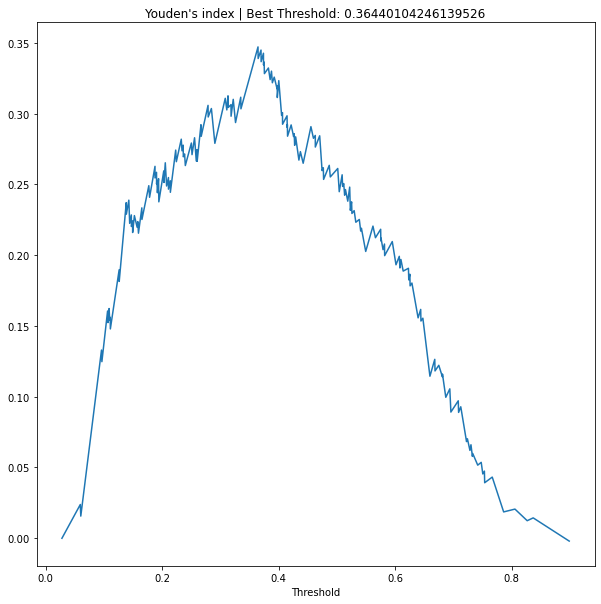

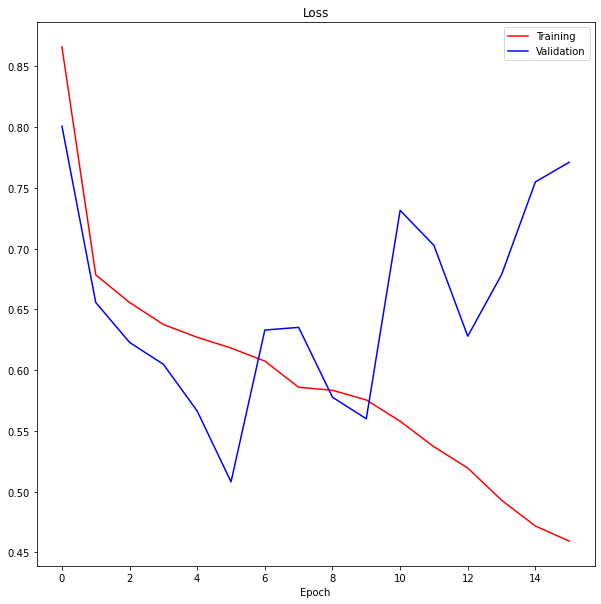

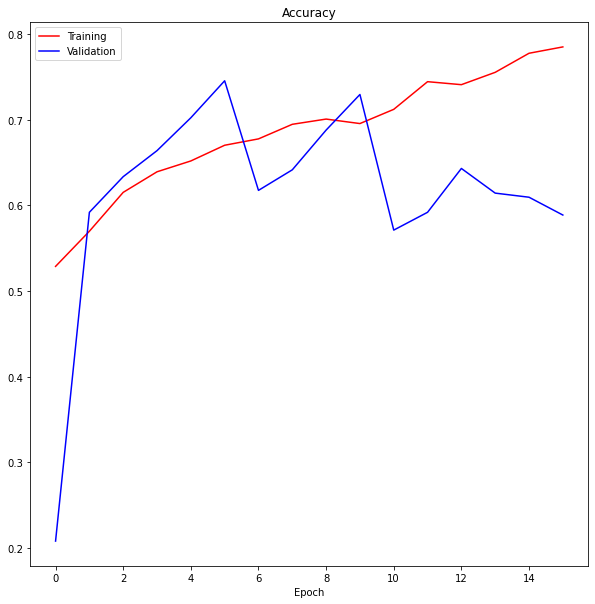

In [14]:
## plot figures
generate_plots(val_Y, pred_Y)
plot_history(history)

Once you feel you are done training, you'll need to decide the proper classification threshold that optimizes your model's performance for a given metric (e.g. accuracy, F1, precision, etc.  You decide) 

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


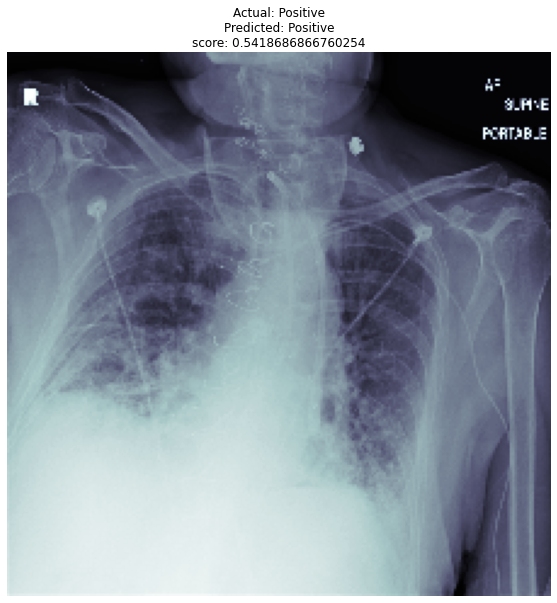

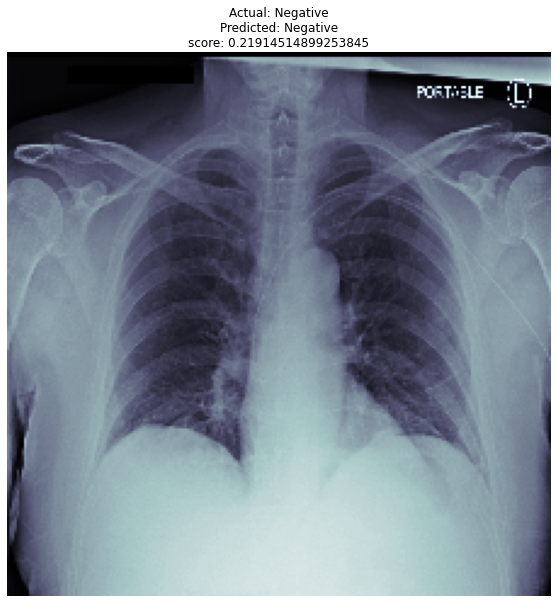

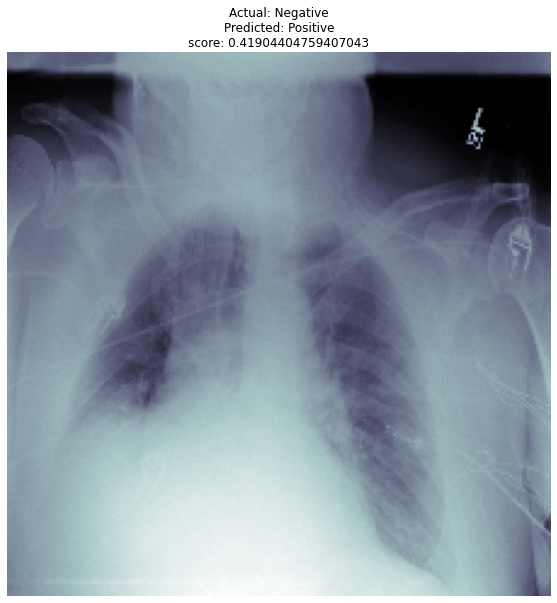

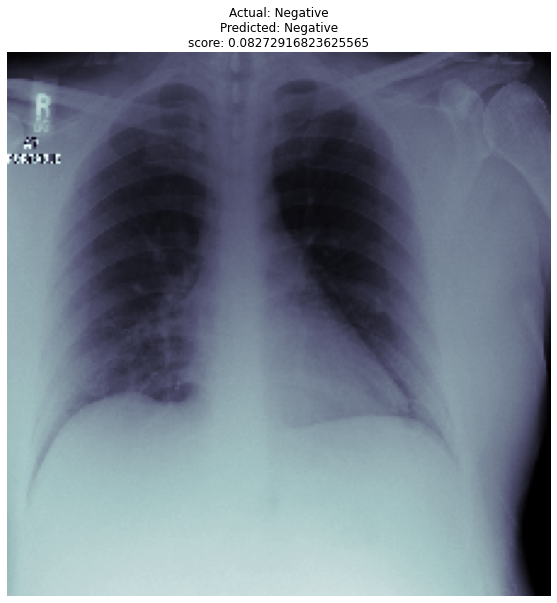

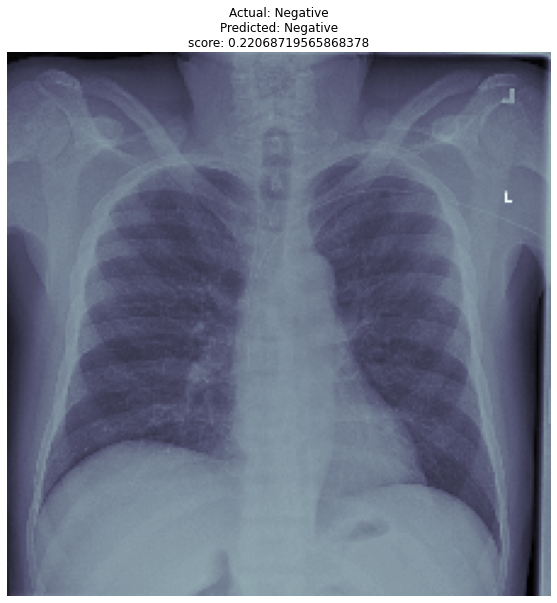

...

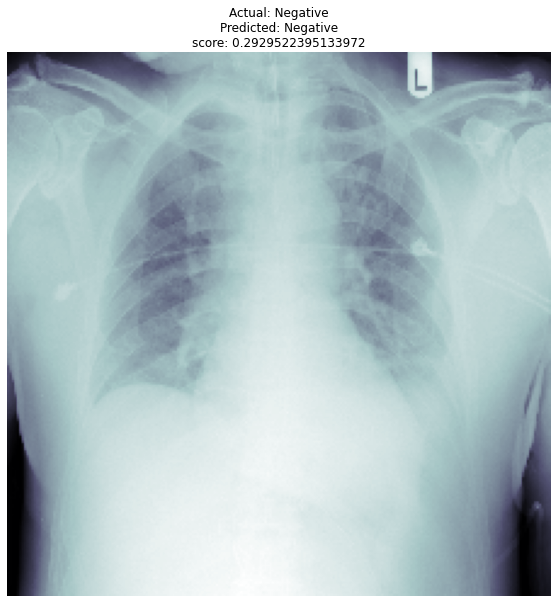

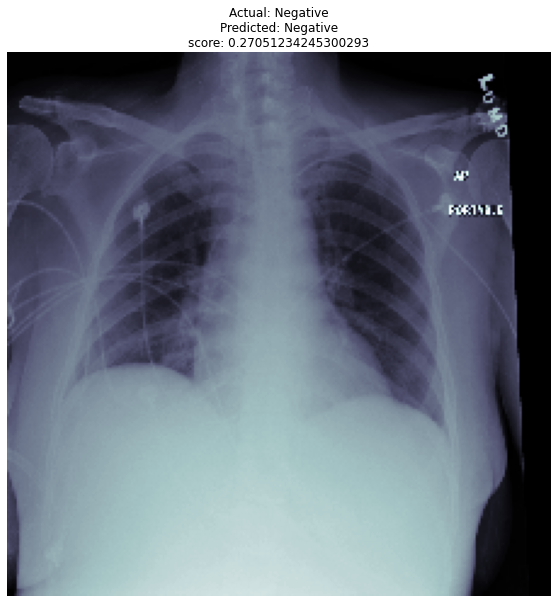

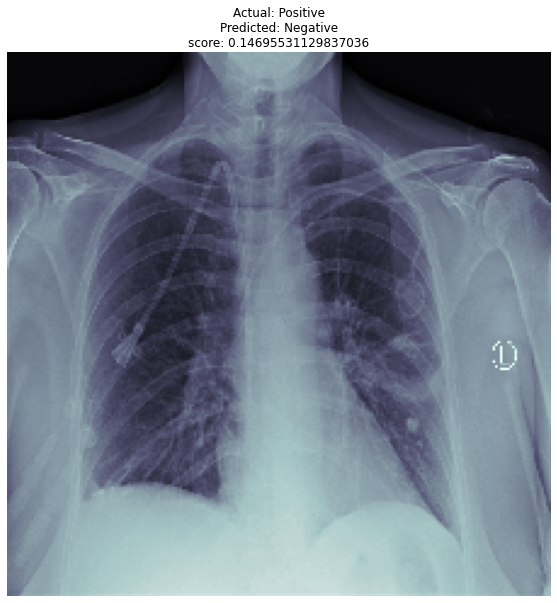

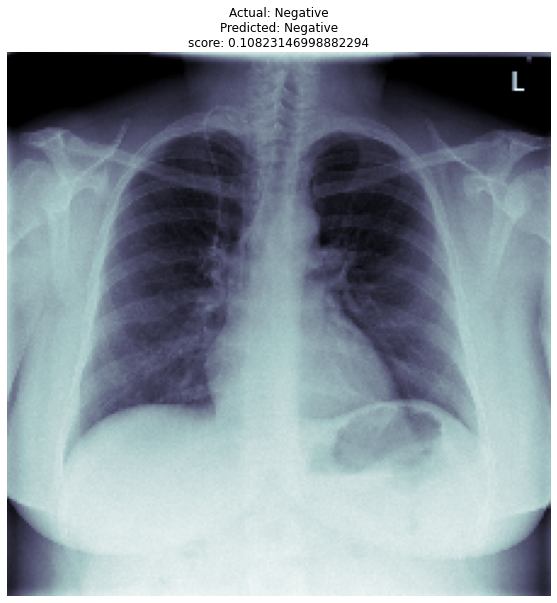

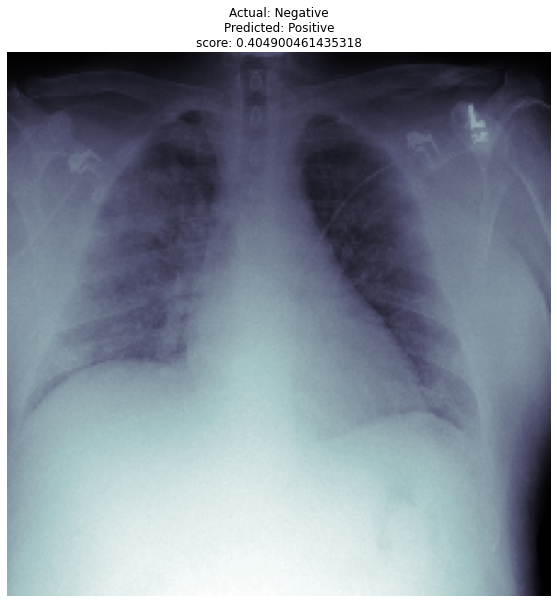

In [15]:
## Let's look at some examples of predicted v. true with our best model: 

# Todo
THRESHOLD = 0.36
predictions = pred_Y >= THRESHOLD
for (c_x, c_y, score, prediction) in zip(val_X[0:100], val_Y[0:100], pred_Y[:, 0], predictions):
    actual_str = "Positive" if c_y == True else "Negative"
    predicted_str = "Positive" if prediction == True else "Negative"
    plt.figure(figsize=(10, 10))
    plt.imshow(c_x[:,:,0], cmap = 'bone')
    plt.title("Actual: {}\nPredicted: {}\nscore: {}".format(actual_str, predicted_str, score))
    plt.axis('off')

(array([104., 128., 103.,  77.,  61.,  51.,  41.,  40.,  16.,   4.]),
 array([0.02791568, 0.11497127, 0.20202687, 0.28908247, 0.37613806,
        0.46319363, 0.5502492 , 0.63730484, 0.7243604 , 0.81141603,
        0.8984716 ], dtype=float32),
 <a list of 10 Patch objects>)

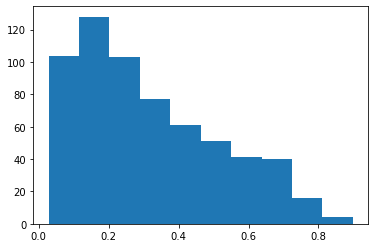

In [16]:
plt.hist(pred_Y)

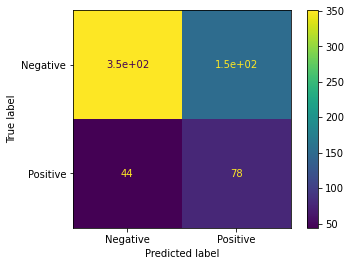

In [17]:
ConfusionMatrixDisplay(confusion_matrix(val_Y, predictions), ['Negative', 'Positive']).plot()

In [18]:
tn, fp, fn, tp = confusion_matrix(val_Y, predictions).ravel()
sensitivity = (1.0 * tp) / (tp + fn)
specificity = (1.0 * tn) / (tn + fp)
print("True Positives: {}".format(tp))
print("False Positives: {}".format(fp))
print("True Negatives: {}".format(tn))
print("False Negatives: {}".format(fn))
print("Sensitivity: {}".format(sensitivity))
print("Specificity: {}".format(specificity))
print("Youden: {}".format(sensitivity + specificity - 1))
print("Precision: {}".format(precision_score(val_Y, predictions)))
print("Recall: {}".format(recall_score(val_Y, predictions)))
print("F1: {}".format(f1_score(val_Y, predictions)))

True Positives: 78
False Positives: 152
True Negatives: 351
False Negatives: 44
Sensitivity: 0.639344262295082
Specificity: 0.6978131212723658
Youden: 0.33715738356744795
Precision: 0.3391304347826087
Recall: 0.639344262295082
F1: 0.4431818181818181


In [19]:
## Just save model architecture to a .json:

model_json = my_model.to_json()
with open("my_model.json", "w") as json_file:
    json_file.write(model_json)